## Data

In [2]:
import glob
import numpy as np
import os
import SimpleITK as sitk

In [3]:
def loadData( rootPath, padding= 25 ):
    print(rootPath,padding)
    imageFilenames = glob.glob(os.path.join(rootPath, "*", "mri", "miT1W_3D_TFE.nii"))
    if len(imageFilenames) == 0: # Load a single subject
        imageFilenames = glob.glob(os.path.join(rootPath, "mri", "miT1W_3D_TFE.nii"))        
    
    flairFilenames = [x.replace('mri\\miT1W_3D_TFE', 'features\\T2_FLAIR') for x in imageFilenames]
    labelFilenames = [x.replace('mri\\miT1W_3D_TFE', 'features\\labels') for x in imageFilenames]
    
    images = None # shape: (numImages, z, y, x, channels=1)
    labels = None
    masks  = None
    
    for imageFilename, flairFilename, labelFilename in zip(imageFilenames, flairFilenames, labelFilenames):
        # Load the images
        imageImage = sitk.ReadImage(imageFilename)
        flairImage = sitk.ReadImage(flairFilename)
        labelImage = sitk.ReadImage(labelFilename)
        # Convert to arrays
        imageArray = np.pad(sitk.GetArrayFromImage(imageImage), [(0,0),(padding,padding),(padding,padding)], 'constant')
        flairArray = np.pad(sitk.GetArrayFromImage(flairImage), [(0,0),(padding,padding),(padding,padding)], 'constant')
        labelArray = np.pad(sitk.GetArrayFromImage(labelImage), [(0,0),(padding,padding),(padding,padding)], 'constant')
        maskArray = labelArray > 0
        
        # Add to the images/labels array
        if images is None:
            images = imageArray.reshape([1] + list(imageArray.shape) + [1])
            images = np.concatenate([images, flairArray.reshape([1] + list(flairArray.shape) + [1])], axis=4)
            labels = labelArray.reshape([1] + list(labelArray.shape) + [1])
            masks  = maskArray.reshape([1] + list(maskArray.shape) + [1])
        else:
            tempArray = np.concatenate([imageArray.reshape([1] + list(imageArray.shape) + [1]), flairArray.reshape([1] + list(flairArray.shape) + [1])], axis=4)
            images = np.concatenate([images, tempArray])
            
            labels = np.concatenate([labels, labelArray.reshape([1] + list(labelArray.shape) + [1])])
            masks  = np.concatenate([masks, maskArray.reshape([1] + list(maskArray.shape) + [1])])              
    return images, labels, masks





def batchTestGeneratorMasked(images, labels, nonZeroIdx, shape):  
    idx = 0
    while idx < len(nonZeroIdx[0]):        
        batchImages = np.zeros(shape, dtype=np.float32)
        batchLabels = np.zeros((shape[0], 1), dtype=np.float32)
        for i in range(shape[0]):              
            zs = nonZeroIdx[1][idx]
            ze = zs + 1
            
            ys = int(nonZeroIdx[2][idx] - 0.5*(shape[1]-1))
            ye = int(nonZeroIdx[2][idx] + 0.5*(shape[1]-1) + 1)
            
            xs = int(nonZeroIdx[3][idx] - 0.5*(shape[2]-1))
            xe = int(nonZeroIdx[3][idx] + 0.5*(shape[2]-1) + 1)            
            
#             print (len(nonZeroIdx))
#             print(idx,nonZeroIdx[0][idx])
            print(batchImages[i,:,:,:].shape,images[nonZeroIdx[0][idx], zs:ze, ys:ye, xs:xe].shape)
            batchImages[i,:,:,:] = images[nonZeroIdx[0][idx], zs:ze, ys:ye, xs:xe]
            
            batchLabels[i] = labels[nonZeroIdx[0][idx], nonZeroIdx[1][idx], nonZeroIdx[2][idx], nonZeroIdx[3][idx] ]
            
            idx += 1      
            
            # Check if we go beyond the image(s)
            if idx >= len(nonZeroIdx[0]):
                break
        
        # In case we have reached the last batch, crop to i+1                      
        yield batchImages[:i+1], batchLabels[:i+1]
    
    return

## Segmentation

In [4]:
import matplotlib.pyplot as plt 


import keras
from keras.datasets import mnist
from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten
from keras.layers import Conv2D, MaxPooling2D, BatchNormalization
from keras import backend as K



import datetime
import glob
import numpy as np
import os
import platform
import SimpleITK as sitk

import pandas as pd

Using TensorFlow backend.


In [5]:
rootPath = "Z:/VoorJing/training"
testPath = "Z:/VoorJing/testing"

batchSize = 60
batchShape = (batchSize, 51, 51, 2)
rs = np.random.RandomState(354351)
num_classes = 14


In [6]:
def batchGeneratorMasked(images, labels, nonZeroIdx, shape, rs=np.random):    
    while True:
        batchImages = np.zeros(shape, dtype=np.float32)
        batchLabels = np.zeros((shape[0], 1), dtype=np.float32)
        sampleIdx = rs.randint(0, len(nonZeroIdx[0]), shape[0])
        
        for idx in range(shape[0]):
            
            zs = nonZeroIdx[1][sampleIdx[idx]]
            ze = zs + 1
            
            ys = int(nonZeroIdx[2][sampleIdx[idx]] - 0.5*(shape[1]-1))
            ye = int(nonZeroIdx[2][sampleIdx[idx]] + 0.5*(shape[1]-1) + 1)
            
            xs = int(nonZeroIdx[3][sampleIdx[idx]] - 0.5*(shape[2]-1))
            xe = int(nonZeroIdx[3][sampleIdx[idx]] + 0.5*(shape[2]-1) + 1)            
            
            try:
                batchImages[idx,:,:,:] = images[nonZeroIdx[0][sampleIdx[idx]], zs:ze, ys:ye, xs:xe]
                batchLabels[idx] = labels[nonZeroIdx[0][sampleIdx[idx]], nonZeroIdx[1][sampleIdx[idx]], nonZeroIdx[2][sampleIdx[idx]], nonZeroIdx[3][sampleIdx[idx]] ]
            except:
                print(xs,xe,ys,ye,zs,ze)    
                raise
                                    
        yield batchImages, batchLabels



In [7]:
import tensorflow as tf
tf.Session(config=tf.ConfigProto(log_device_placement=True))
tf.test.gpu_device_name()

'/device:GPU:0'

In [8]:
images,labels, masks = loadData(rootPath, padding=25)
nonZeroIdx = np.nonzero(masks)

testImages, testLabels, testMasks = loadData(testPath, padding=25)
testNonZeroIdx = np.nonzero(testMasks)

Z:/VoorJing/training 25
Z:/VoorJing/testing 25


In [ ]:
#%%
model = Sequential()
model.add(Conv2D(32, kernel_size=(3, 3),
                 activation='relu',
                 input_shape=batchShape[1:]))
model.add(BatchNormalization())
model.add(Conv2D(32, (3, 3), activation='relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(32, (3, 3), activation='relu'))
model.add(BatchNormalization())
model.add(Conv2D(32, (3, 3), activation='relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(32, (3, 3), activation='relu'))
model.add(BatchNormalization())
model.add(Conv2D(32, (3, 3), activation='relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Flatten())
model.add(Dense(64, activation='relu'))
model.add(BatchNormalization())
#model.add(Dropout(0.5))
model.add(Dense(64, activation='relu'))
model.add(BatchNormalization())

#model.add(Dropout(0.5))
model.add(Dense(num_classes, activation='softmax'))


model.compile(loss=keras.losses.categorical_crossentropy,
              #optimizer=keras.optimizers.Adadelta(),
              optimizer=keras.optimizers.Adam(),
              metrics=['accuracy'])

model.summary()

#%%

#iterator = batchGenerator(images, labels, batchShape, rs)
iterator = batchGeneratorMasked(images, labels, nonZeroIdx, batchShape, rs)
tbCallBack = keras.callbacks.TensorBoard(log_dir='D:/tensorflow_log/train', histogram_freq=0, write_graph=True, write_images=True)

df = None
max_iters = 50000
for idx, (x_train, y_train) in enumerate(iterator):
    y_train = keras.utils.to_categorical(y_train, num_classes)
    
    if idx % 5000 == 0:
        x_test, y_test = next(batchGeneratorMasked(testImages, testLabels, testNonZeroIdx, batchShape))
        y_test = keras.utils.to_categorical(y_test, num_classes)        
        
        score = model.fit(x_train, y_train,
                  batch_size=batchSize,
                  verbose=0,
                  validation_data=(x_test, y_test),
                  )
        
        score.history['idx']= idx
        
        if df is None:
            df = pd.DataFrame.from_dict(score.history)
        else:
            df = df.append(pd.DataFrame.from_dict(score.history))
            
        # Store the params
        model.save('C:/Users/Jing/Documents/umcu/src/model/cnn_brain_segmentation_model_' + datetime.datetime.today().strftime('%Y%m%d_%H%M%S') + '_idx.h5')
                
        plt.plot(df.idx, df.acc, df.idx, df.val_acc, df.idx, df.acc.rolling(10).mean(), df.idx, df.val_acc.rolling(10).mean())
        try:
            plt.savefig('D:/tensorflow_log/train.png', dpi=200)
            plt.close()
        except:
            pass
    else:
        model.fit(x_train, y_train,
                  batch_size=batchSize,
                  verbose=0,
                  )
    
    if idx == max_iters:
        break

#11.42 gestart
model.save('C:/Users/Jing/Documents/umcu/src/model/cnn_brain_segmentation_model_' + datetime.datetime.today().strftime('%Y%m%d_%H%M%S') + '.h5')

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 49, 49, 32)        608       
_________________________________________________________________
batch_normalization_1 (Batch (None, 49, 49, 32)        128       
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 47, 47, 32)        9248      
_________________________________________________________________
batch_normalization_2 (Batch (None, 47, 47, 32)        128       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 23, 23, 32)        0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 21, 21, 32)        9248      
_________________________________________________________________
batch_normalization_3 (Batch (None, 21, 21, 32)        128       
__________

In [ ]:
y_train,shape

## apply model


In [16]:
from keras.models import Model, Sequential

In [17]:
batchSize = 150
batchShape = (batchSize, 51, 51, 2)
testPath = "Z:/VoorJing/extra-test"
#%%        
        
testImages, testLabels, testMasks = loadData(testPath)
testNonZeroIdx = np.nonzero(testMasks)
print("testImages, testLabels, testMasks",testImages.shape,testLabels.shape,testMasks.shape)
#%%

model = keras.models.load_model("C:/Users/Jing/Documents/umcu/src/model/cnn_brain_segmentation_model_20181003_122621.h5")
novelty_model = Model(inputs=model.input, outputs=model.get_layer("dense_11").output)

#%%
iterator = batchTestGeneratorMasked(testImages, testLabels, testNonZeroIdx, batchShape)

i = 0
r = 0
result = None
novelty = None

for predictImages, predictLabels in iterator:
    resultModel = model.predict_on_batch(predictImages)
    resultNovelty = novelty_model.predict_on_batch(predictImages)
    
    if result is None:
        result = resultModel
        novelty = resultNovelty
    else:
        result = np.concatenate([result, resultModel])
        novelty = np.concatenate([novelty, resultNovelty])
        r+=1
        if r%20==0:
            print (r)
#result = model.predict_generator(iterator, len(testNonZeroIdx[0]))


#%%
dst = np.zeros((1, 48, 240, 240, 1), dtype=np.int8)
dst[testMasks] = np.argmax(result, axis=1)
for k,i in enumerate(dst):
    a = sitk.GetImageFromArray(i[:,:,:,0])
    sitk.WriteImage(a,'"C:/Users/Jing/Documents/umcu/src/model/'+str(k)+'.nii') 
    print(i[:,:,:,0].shape) 

Z:/VoorJing/extra-test 25
testImages, testLabels, testMasks (1, 48, 290, 290, 2) (1, 48, 290, 290, 1) (1, 48, 290, 290, 1)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

40
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

100
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

160
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

220
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

280
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

340
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

400
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

460
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

520
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

580
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

640
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

700
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

760
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

820
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

880
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

940
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

1000
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

1060
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

1120
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

1180
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

1240
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

1300
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

1360
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

1420
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

1480
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

1540
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

1600
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

1660
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

1720
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

1780
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

1840
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

1900
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

1960
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

2020
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

2080
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

2140
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

2200
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

2260
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

2320
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

2380
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

2440
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

2500
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

2560
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

2620
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

2680
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

2740
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

2800
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

2860
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

2920
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

2980
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

3040
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

3100
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

3160
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

3220
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

3280
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

3340
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

3400
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

3460
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

3520
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

3580
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

3640
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

3700
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

3760
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

3820
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

3880
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51,

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)
(

(51, 51, 2) (1, 51, 51, 2)
(51, 51, 2) (1, 51, 51, 2)


IndexError: boolean index did not match indexed array along dimension 2; dimension is 240 but corresponding boolean dimension is 290

In [18]:
result.shape

(586202, 14)

In [19]:
novelty.shape

(586202, 64)

In [20]:
pickle.dump( result,  open( 'model_20181005_etest.pickle', 'wb' ) )
pickle.dump( novelty ,  open( 'novelty_20181005_etest.pickle', 'wb' ) )

In [ ]:
pickle.dump( result,  open( 'model_20181005.pickle', 'wb' ) )
pickle.dump( novelty ,  open( 'novelty_20181005.pickle', 'wb' ) )

In [21]:
def myshow(img, title=None, margin=0.05, dpi=100):
    nda = sitk.GetArrayViewFromImage(img)
    spacing = img.GetSpacing()
        
    if nda.ndim == 3:
        # fastest dim, either component or x
        c = nda.shape[-1]
        
        # the the number of components is 3 or 4 consider it an RGB image
        if not c in (3,4):
            nda = nda[nda.shape[0]//2,:,:]
    
    elif nda.ndim == 4:
        c = nda.shape[-1]
        
        if not c in (3,4):
            raise Runtime("Unable to show 3D-vector Image")
            
        # take a z-slice
        nda = nda[nda.shape[0]//2,:,:,:]
            
    ysize = nda.shape[0]
    xsize = nda.shape[1]
      
    # Make a figure big enough to accommodate an axis of xpixels by ypixels
    # as well as the ticklabels, etc...
    figsize = (4 + margin) * ysize / dpi, (4 + margin) * xsize / dpi

    fig = plt.figure(figsize=figsize, dpi=dpi)
    # Make the axis the right size...
    ax = fig.add_axes([margin, margin, 1 - 2*margin, 1 - 2*margin])
   
    extent = (0, xsize*spacing[1], ysize*spacing[0], 0)
    
    t = ax.imshow(nda,extent=extent,interpolation=None)
    
    if nda.ndim == 2:
        t.set_cmap("gray")
    
    if(title):
        plt.title(title)

(48, 290, 290)


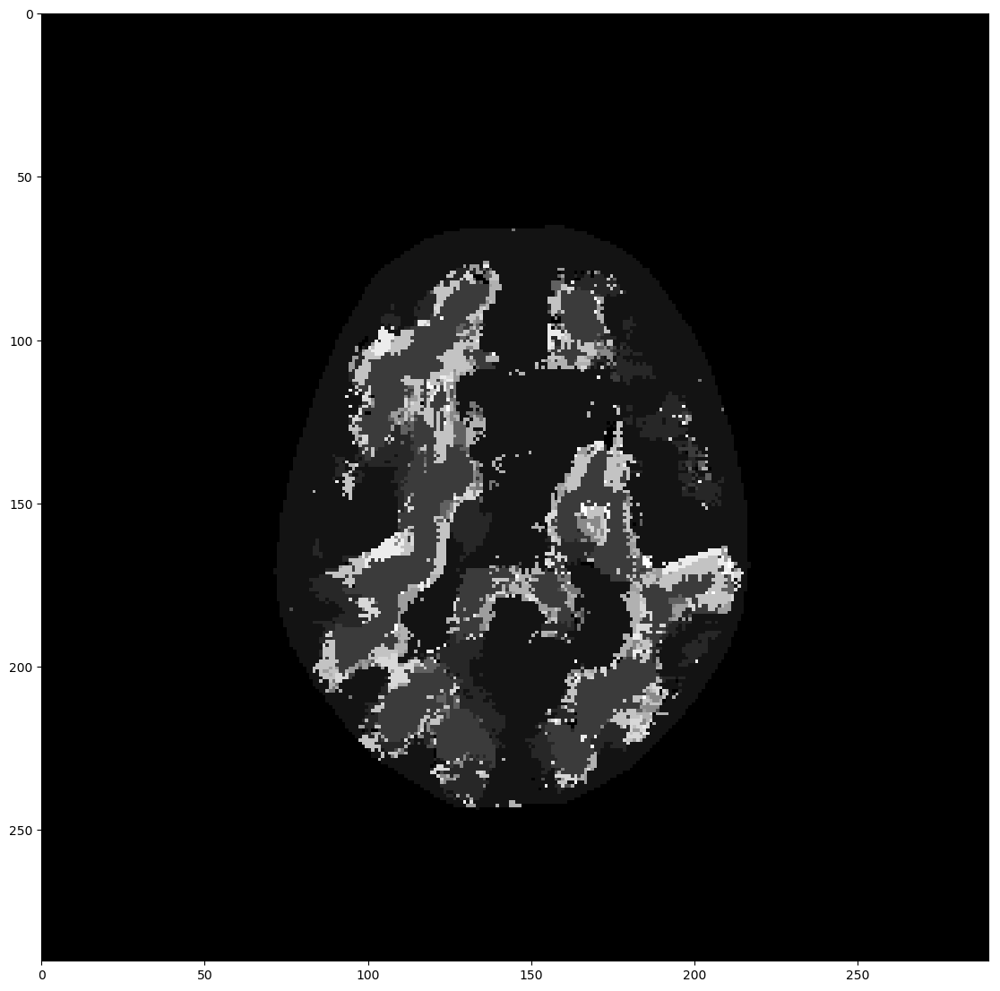

In [23]:
dst = np.zeros((1, 48, 290, 290, 1), dtype=np.int8)
dst[testMasks] = np.argmax(result, axis=1)
for k,i in enumerate(dst):
    a = sitk.GetImageFromArray(i[:,:,:,0])
    myshow(a)
    sitk.WriteImage(a,'C:/Users/Jing/Documents/umcu/src/model/'+str(k)+'.nii') 
    print(i[:,:,:,0].shape)

## Novelty

In [24]:
import data

import datetime
import numpy as np
import platform
import SimpleITK as sitk
import sklearn.cross_validation
import sklearn.neighbors
import scipy.ndimage.measurements
import time

import cyflann
import pickle

In [25]:
with open("model_20181005.pickle", 'rb') as f:
    result = pickle.load(f)
with open("novelty_20181005.pickle", 'rb') as f1:
    novelty = pickle.load(f1)

In [26]:
print(result.shape,novelty.shape)

(2371450, 14) (2371450, 64)


In [27]:
with open("model_result_novelty.pickle", "wb") as f:
    pickle.dump( { 'result': result, 'novelty': novelty } , f)

In [28]:
with open("model_result_novelty.pickle", 'rb') as f:
    raw = pickle.load(f)
result = raw['result']
novelty = raw['novelty']

In [29]:
s = np.random.randint(0, len(novelty), 50000)
idx = cyflann.FLANNIndex(algorithm='linear')
idx.build_index(novelty[s]) 

In [30]:
feature_avg = np.mean(novelty , axis=1)
feature_std = np.std(novelty , axis=1)

In [39]:
testImages, testLabels, testMasks = data.loadData("Z:/VoorJing/extra-test/D11", padding=25)
testNonZeroIdx = np.nonzero(testMasks)

# with open("D:\\data\\wml-distance\\extra-test\\D11_20180620_084746.pickle", 'rb') as f:
#     raw = pickle.load(f)
# testResult  = np.argmax(raw['result'], axis=1)
# testNovelty = raw['novelty']

with open("model_20181005_etest.pickle", 'rb') as f:
    testResult  = np.argmax(pickle.load(f), axis=1)
with open("novelty_20181005_etest.pickle", 'rb') as f1:
    testNovelty = pickle.load(f1)

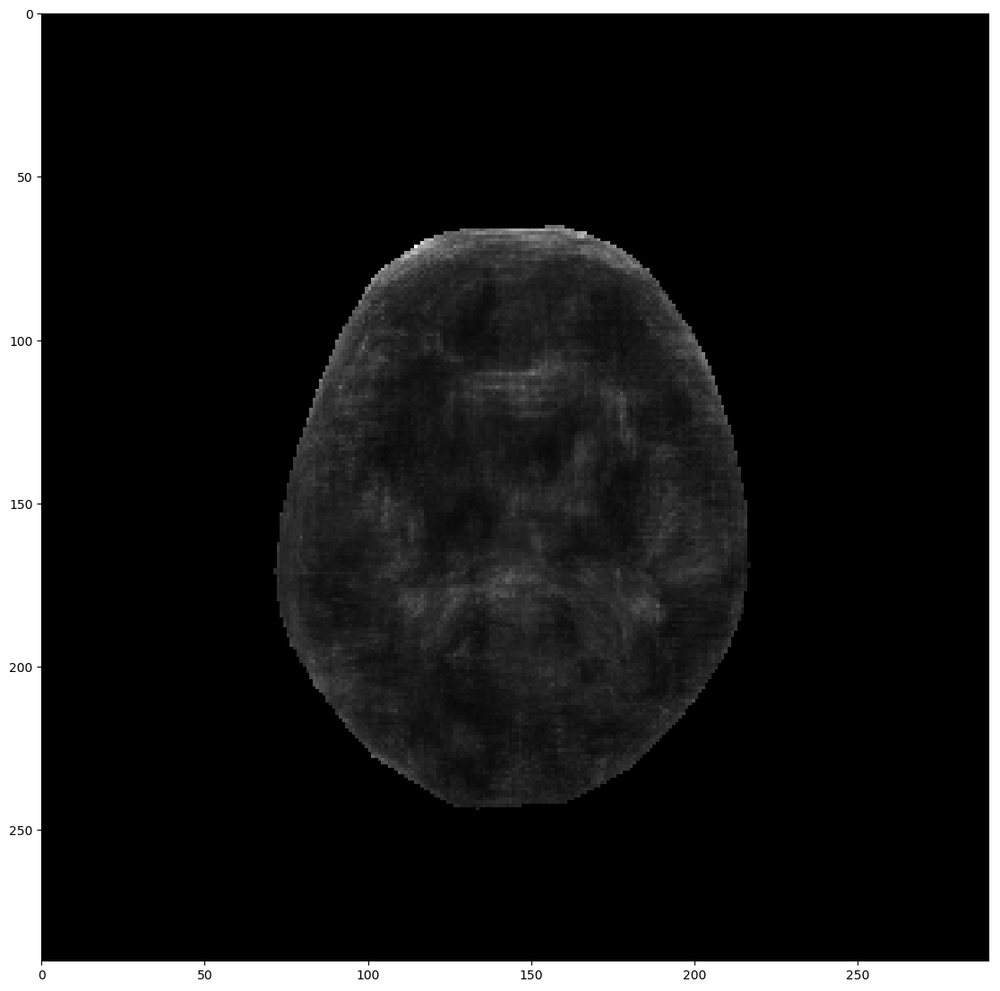

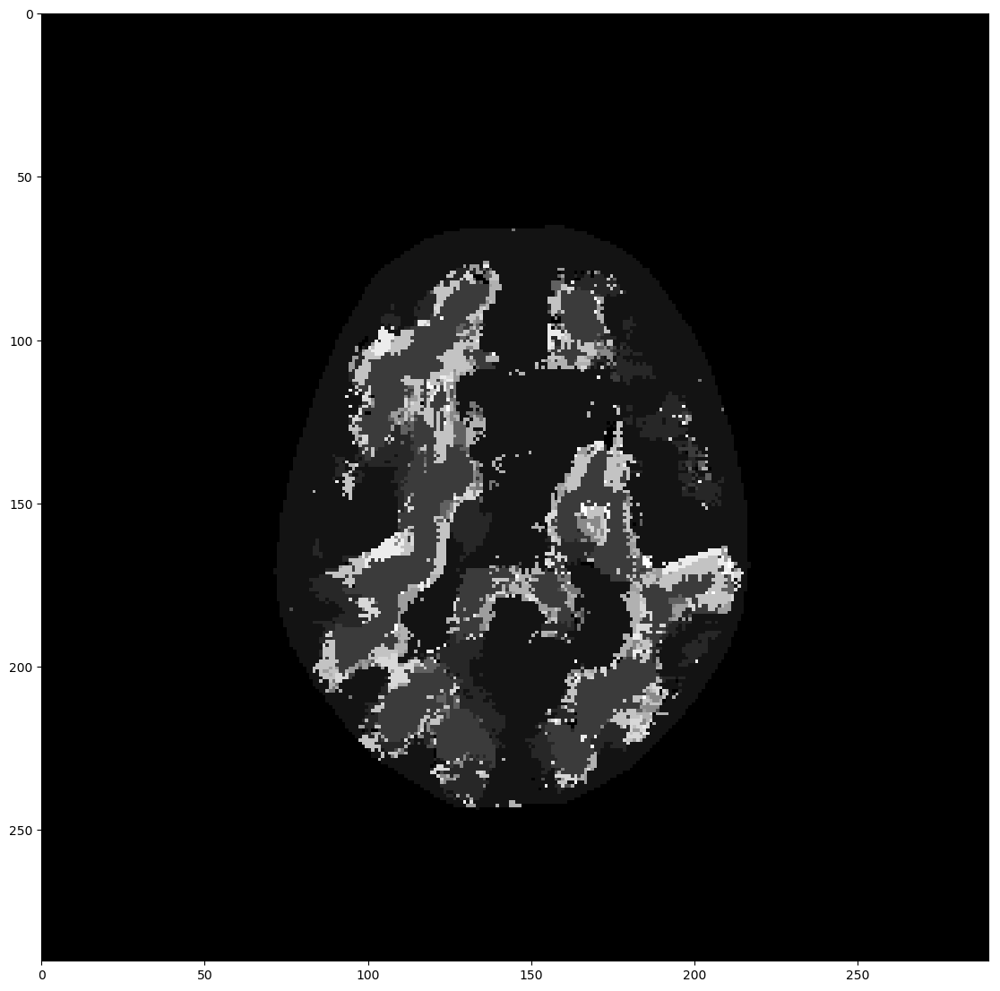

In [40]:
#%% Run the subject through the NN

test_ind, test_dist = idx.nn_index(testNovelty, 51)
test_dist_feature = np.mean(test_dist, axis=1)
zscore = (test_dist_feature - feature_avg[testResult]) / feature_std[testResult]

zdst = np.zeros(testMasks.shape)
zdst[testMasks] = zscore

zImage = sitk.GetImageFromArray(zdst[0,:,:,:,0])
myshow(zImage)
sitk.WriteImage(zImage, "C:/Users/Jing/Documents/umcu/src/model/zscore_20180620_163243.nii")

rdst = np.zeros(testMasks.shape)
rdst[testMasks] = testResult
zImage = sitk.GetImageFromArray(rdst[0,:,:,:,0])
myshow(zImage)
sitk.WriteImage(zImage, "C:/Users/Jing/Documents/umcu/src/model/zsegm_20180620_163243.nii")